In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import sklearn
import cv2

%matplotlib inline

In [2]:
FINAL_DATA = '/Users/ninz/thesis/data/final_data'

In [3]:
test_image = os.path.join(FINAL_DATA, '2_3.JPG')

In [4]:
original_image = cv2.imread(test_image)
image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

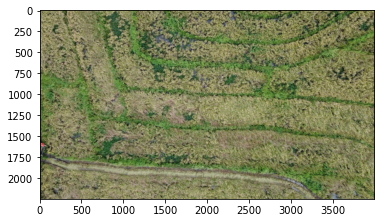

In [5]:
plt.imshow(image)
plt.show()

In [8]:
# Followed from this example: https://www.kdnuggets.com/2019/08/introduction-image-segmentation-k-means-clustering.html
def get_cluster(image, k, attempts):
    vectorized = image.reshape((-1,3))
    vectorized = np.float32(vectorized)
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)

    ret, label, center = cv2.kmeans(vectorized, k, None, criteria, attempts, cv2.KMEANS_PP_CENTERS)
    center = np.uint8(center)
    res = center[label.flatten()]
    result_image = res.reshape((image.shape))
    
    figure_size = 100
    plt.figure(figsize=(figure_size,figure_size))
    plt.subplot(1,2,1)
    plt.imshow(image)
    plt.title('Original Image')
    plt.subplot(1,2,2)
    plt.imshow(result_image)
    plt.title('Segmented Image when K = %i' % k)
    plt.show()

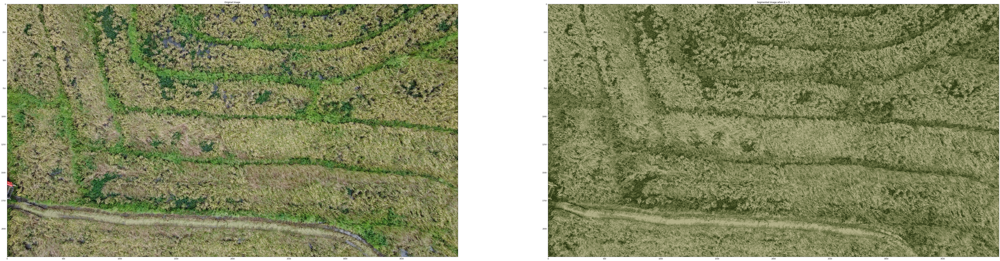

In [9]:
get_cluster(image, 5, 10)

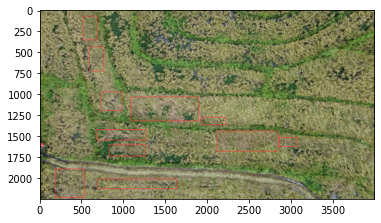

In [10]:
annotated_image = os.path.join(FINAL_DATA, 'out-2_3.JPG')
annotated_image = cv2.imread(annotated_image)
annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)

plt.imshow(annotated_image)
plt.show()

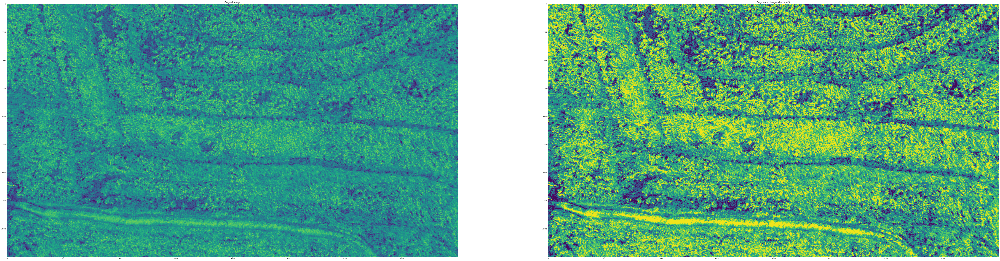

In [12]:
gray = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
get_cluster(gray, 5, 10)

In [13]:
# Histogram for each boxes vs outside of all boxes

In [14]:
# Divide images to grid, check characteristics of each grid. grid with damage vs grid w/o damage